In [1]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)


Random Seed:  999


In [2]:
# set up the directories
from pathgen.utils.seeds import set_seed
from pathgen.utils.paths import project_root

experiment_name = "one"
experiment_root = project_root() / "experiments" / experiment_name

train_patches_dir = experiment_root / 'camelyon16_patches_for_gan_training/train/normal'

In [3]:
# Number of workers for dataloader
workers = 16

# Batch size during training
batch_size = 256

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 200

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = torch.cuda.device_count()

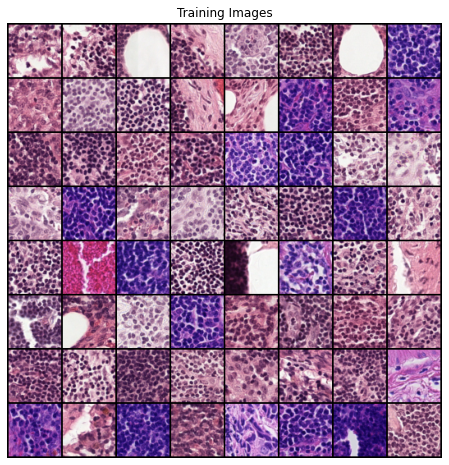

In [4]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=train_patches_dir,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [5]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)


In [6]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [7]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

DataParallel(
  (module): Generator(
    (main): Sequential(
      (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
      (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (8): ReLU(inplace=True)
      (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (11): ReLU(inplace=True)
      (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2

In [8]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [9]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

DataParallel(
  (module): Discriminator(
    (main): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
      (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (4): LeakyReLU(negative_slope=0.2, inplace=True)
      (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (7): LeakyReLU(negative_slope=0.2, inplace=True)
      (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (10): LeakyReLU(negative_slope=0.2, inplace=True)
      (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    

In [10]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [11]:
%%time

# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/200][0/118]	Loss_D: 1.6601	Loss_G: 5.8676	D(x): 0.5352	D(G(z)): 0.5245 / 0.0048
[0/200][50/118]	Loss_D: 0.5824	Loss_G: 7.3902	D(x): 0.9247	D(G(z)): 0.3321 / 0.0027
[0/200][100/118]	Loss_D: 0.3769	Loss_G: 2.9378	D(x): 0.8668	D(G(z)): 0.1879 / 0.0828
[1/200][0/118]	Loss_D: 1.5672	Loss_G: 8.4483	D(x): 0.9913	D(G(z)): 0.7537 / 0.0006
[1/200][50/118]	Loss_D: 0.0790	Loss_G: 4.5302	D(x): 0.9616	D(G(z)): 0.0381 / 0.0135
[1/200][100/118]	Loss_D: 0.8644	Loss_G: 10.9583	D(x): 0.5313	D(G(z)): 0.0000 / 0.0001
[2/200][0/118]	Loss_D: 0.2692	Loss_G: 6.3940	D(x): 0.9730	D(G(z)): 0.1932 / 0.0024
[2/200][50/118]	Loss_D: 0.6429	Loss_G: 6.4380	D(x): 0.6493	D(G(z)): 0.0017 / 0.0088
[2/200][100/118]	Loss_D: 0.3097	Loss_G: 3.4881	D(x): 0.8520	D(G(z)): 0.1188 / 0.0408
[3/200][0/118]	Loss_D: 0.3674	Loss_G: 3.5260	D(x): 0.9077	D(G(z)): 0.2159 / 0.0372
[3/200][50/118]	Loss_D: 0.2998	Loss_G: 5.2225	D(x): 0.9739	D(G(z)): 0.2029 / 0.0112
[3/200][100/118]	Loss_D: 0.3884	Loss_G: 3.0909	D(x

[32/200][50/118]	Loss_D: 0.1081	Loss_G: 2.9884	D(x): 0.9823	D(G(z)): 0.0797 / 0.0837
[32/200][100/118]	Loss_D: 0.2694	Loss_G: 5.9162	D(x): 0.9798	D(G(z)): 0.2010 / 0.0043
[33/200][0/118]	Loss_D: 0.4938	Loss_G: 4.5920	D(x): 0.7014	D(G(z)): 0.0064 / 0.0239
[33/200][50/118]	Loss_D: 0.8084	Loss_G: 3.5578	D(x): 0.5798	D(G(z)): 0.0031 / 0.1032
[33/200][100/118]	Loss_D: 0.9348	Loss_G: 3.9783	D(x): 0.4553	D(G(z)): 0.0004 / 0.0391
[34/200][0/118]	Loss_D: 1.1755	Loss_G: 13.5746	D(x): 0.9978	D(G(z)): 0.5970 / 0.0000
[34/200][50/118]	Loss_D: 0.2622	Loss_G: 5.2718	D(x): 0.9837	D(G(z)): 0.1993 / 0.0108
[34/200][100/118]	Loss_D: 0.1440	Loss_G: 5.3213	D(x): 0.9550	D(G(z)): 0.0840 / 0.0088
[35/200][0/118]	Loss_D: 0.1358	Loss_G: 5.6798	D(x): 0.9671	D(G(z)): 0.0895 / 0.0066
[35/200][50/118]	Loss_D: 0.1946	Loss_G: 3.5690	D(x): 0.9200	D(G(z)): 0.0881 / 0.0441
[35/200][100/118]	Loss_D: 0.1497	Loss_G: 5.2721	D(x): 0.9459	D(G(z)): 0.0813 / 0.0077
[36/200][0/118]	Loss_D: 0.1216	Loss_G: 6.3480	D(x): 0.9467	D(G(

[64/200][100/118]	Loss_D: 0.1639	Loss_G: 6.3160	D(x): 0.9762	D(G(z)): 0.0991 / 0.0068
[65/200][0/118]	Loss_D: 0.0438	Loss_G: 8.1576	D(x): 0.9636	D(G(z)): 0.0027 / 0.0025
[65/200][50/118]	Loss_D: 0.2071	Loss_G: 8.3330	D(x): 0.9794	D(G(z)): 0.1579 / 0.0004
[65/200][100/118]	Loss_D: 0.2723	Loss_G: 5.5917	D(x): 0.8170	D(G(z)): 0.0029 / 0.0088
[66/200][0/118]	Loss_D: 5.8237	Loss_G: 5.0129	D(x): 0.0568	D(G(z)): 0.0000 / 0.0780
[66/200][50/118]	Loss_D: 0.1719	Loss_G: 5.6604	D(x): 0.9637	D(G(z)): 0.1130 / 0.0070
[66/200][100/118]	Loss_D: 0.1030	Loss_G: 6.3866	D(x): 0.9811	D(G(z)): 0.0755 / 0.0029
[67/200][0/118]	Loss_D: 0.1654	Loss_G: 7.3048	D(x): 0.8811	D(G(z)): 0.0044 / 0.0040
[67/200][50/118]	Loss_D: 0.0648	Loss_G: 6.0579	D(x): 0.9877	D(G(z)): 0.0471 / 0.0055
[67/200][100/118]	Loss_D: 0.3957	Loss_G: 9.9133	D(x): 0.9508	D(G(z)): 0.2328 / 0.0002
[68/200][0/118]	Loss_D: 1.3844	Loss_G: 5.8816	D(x): 0.4624	D(G(z)): 0.0001 / 0.0282
[68/200][50/118]	Loss_D: 0.1115	Loss_G: 5.6466	D(x): 0.9707	D(G(z

[97/200][0/118]	Loss_D: 0.0763	Loss_G: 6.0971	D(x): 0.9527	D(G(z)): 0.0196 / 0.0060
[97/200][50/118]	Loss_D: 0.0806	Loss_G: 5.6269	D(x): 0.9534	D(G(z)): 0.0214 / 0.0068
[97/200][100/118]	Loss_D: 0.1037	Loss_G: 4.9903	D(x): 0.9278	D(G(z)): 0.0177 / 0.0137
[98/200][0/118]	Loss_D: 0.0651	Loss_G: 5.4711	D(x): 0.9628	D(G(z)): 0.0229 / 0.0100
[98/200][50/118]	Loss_D: 0.5266	Loss_G: 14.2023	D(x): 0.9338	D(G(z)): 0.2912 / 0.0001
[98/200][100/118]	Loss_D: 0.0907	Loss_G: 5.5036	D(x): 0.9722	D(G(z)): 0.0539 / 0.0078
[99/200][0/118]	Loss_D: 0.1434	Loss_G: 6.7237	D(x): 0.9836	D(G(z)): 0.1101 / 0.0024
[99/200][50/118]	Loss_D: 0.0801	Loss_G: 5.5450	D(x): 0.9548	D(G(z)): 0.0268 / 0.0074
[99/200][100/118]	Loss_D: 0.2015	Loss_G: 3.3919	D(x): 0.8602	D(G(z)): 0.0135 / 0.0620
[100/200][0/118]	Loss_D: 0.1156	Loss_G: 6.7473	D(x): 0.9951	D(G(z)): 0.0926 / 0.0032
[100/200][50/118]	Loss_D: 0.0972	Loss_G: 6.5550	D(x): 0.9727	D(G(z)): 0.0605 / 0.0033
[100/200][100/118]	Loss_D: 0.0670	Loss_G: 6.5414	D(x): 0.9847	D

[129/200][0/118]	Loss_D: 0.1291	Loss_G: 8.6106	D(x): 0.9912	D(G(z)): 0.0967 / 0.0004
[129/200][50/118]	Loss_D: 0.0532	Loss_G: 6.6682	D(x): 0.9639	D(G(z)): 0.0117 / 0.0030
[129/200][100/118]	Loss_D: 0.3541	Loss_G: 11.1333	D(x): 0.9743	D(G(z)): 0.2430 / 0.0000
[130/200][0/118]	Loss_D: 0.0525	Loss_G: 5.9316	D(x): 0.9843	D(G(z)): 0.0340 / 0.0055
[130/200][50/118]	Loss_D: 0.0585	Loss_G: 4.9542	D(x): 0.9694	D(G(z)): 0.0236 / 0.0157
[130/200][100/118]	Loss_D: 0.0715	Loss_G: 6.6692	D(x): 0.9945	D(G(z)): 0.0597 / 0.0034
[131/200][0/118]	Loss_D: 1.0694	Loss_G: 25.0221	D(x): 0.9996	D(G(z)): 0.5431 / 0.0000
[131/200][50/118]	Loss_D: 0.0852	Loss_G: 5.6866	D(x): 0.9584	D(G(z)): 0.0336 / 0.0066
[131/200][100/118]	Loss_D: 0.1045	Loss_G: 7.0124	D(x): 0.9808	D(G(z)): 0.0755 / 0.0017
[132/200][0/118]	Loss_D: 0.1459	Loss_G: 9.5448	D(x): 0.9973	D(G(z)): 0.1205 / 0.0002
[132/200][50/118]	Loss_D: 0.0685	Loss_G: 5.7414	D(x): 0.9781	D(G(z)): 0.0428 / 0.0058
[132/200][100/118]	Loss_D: 0.2118	Loss_G: 3.4800	D(x)

[161/200][0/118]	Loss_D: 0.0644	Loss_G: 6.0857	D(x): 0.9942	D(G(z)): 0.0532 / 0.0048
[161/200][50/118]	Loss_D: 0.2071	Loss_G: 3.5335	D(x): 0.8852	D(G(z)): 0.0467 / 0.0556
[161/200][100/118]	Loss_D: 0.0396	Loss_G: 5.6684	D(x): 0.9690	D(G(z)): 0.0051 / 0.0082
[162/200][0/118]	Loss_D: 2.4606	Loss_G: 31.9369	D(x): 1.0000	D(G(z)): 0.8198 / 0.0000
[162/200][50/118]	Loss_D: 0.1061	Loss_G: 6.5200	D(x): 0.9915	D(G(z)): 0.0779 / 0.0033
[162/200][100/118]	Loss_D: 0.2656	Loss_G: 10.7672	D(x): 0.9868	D(G(z)): 0.1915 / 0.0001
[163/200][0/118]	Loss_D: 0.0897	Loss_G: 7.5319	D(x): 0.9983	D(G(z)): 0.0771 / 0.0014
[163/200][50/118]	Loss_D: 0.0598	Loss_G: 6.1177	D(x): 0.9992	D(G(z)): 0.0507 / 0.0048
[163/200][100/118]	Loss_D: 0.1222	Loss_G: 4.9518	D(x): 0.9387	D(G(z)): 0.0348 / 0.0158
[164/200][0/118]	Loss_D: 0.0504	Loss_G: 6.4135	D(x): 0.9759	D(G(z)): 0.0228 / 0.0051
[164/200][50/118]	Loss_D: 0.0801	Loss_G: 7.9837	D(x): 0.9970	D(G(z)): 0.0685 / 0.0007
[164/200][100/118]	Loss_D: 0.0588	Loss_G: 6.3317	D(x)

[193/200][0/118]	Loss_D: 1.0298	Loss_G: 23.4776	D(x): 0.9987	D(G(z)): 0.5239 / 0.0000
[193/200][50/118]	Loss_D: 0.0558	Loss_G: 5.9884	D(x): 0.9800	D(G(z)): 0.0326 / 0.0044
[193/200][100/118]	Loss_D: 0.1405	Loss_G: 9.6018	D(x): 0.9947	D(G(z)): 0.1136 / 0.0001
[194/200][0/118]	Loss_D: 0.1234	Loss_G: 8.6034	D(x): 0.9950	D(G(z)): 0.1022 / 0.0005
[194/200][50/118]	Loss_D: 0.0822	Loss_G: 6.8508	D(x): 0.9340	D(G(z)): 0.0028 / 0.0036
[194/200][100/118]	Loss_D: 0.0825	Loss_G: 4.9475	D(x): 0.9570	D(G(z)): 0.0305 / 0.0160
[195/200][0/118]	Loss_D: 3.5151	Loss_G: 31.3819	D(x): 1.0000	D(G(z)): 0.9065 / 0.0000
[195/200][50/118]	Loss_D: 0.0591	Loss_G: 6.7447	D(x): 0.9525	D(G(z)): 0.0062 / 0.0029
[195/200][100/118]	Loss_D: 0.1021	Loss_G: 7.6054	D(x): 0.9952	D(G(z)): 0.0805 / 0.0014
[196/200][0/118]	Loss_D: 0.0777	Loss_G: 7.1016	D(x): 0.9948	D(G(z)): 0.0651 / 0.0019
[196/200][50/118]	Loss_D: 0.0385	Loss_G: 6.0970	D(x): 0.9778	D(G(z)): 0.0143 / 0.0048
[196/200][100/118]	Loss_D: 0.0257	Loss_G: 11.0972	D(x

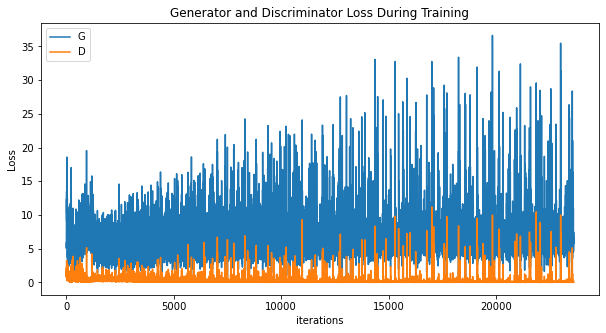

In [12]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21574877 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


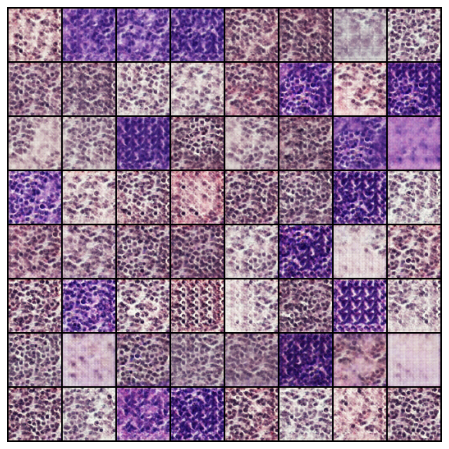

In [13]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

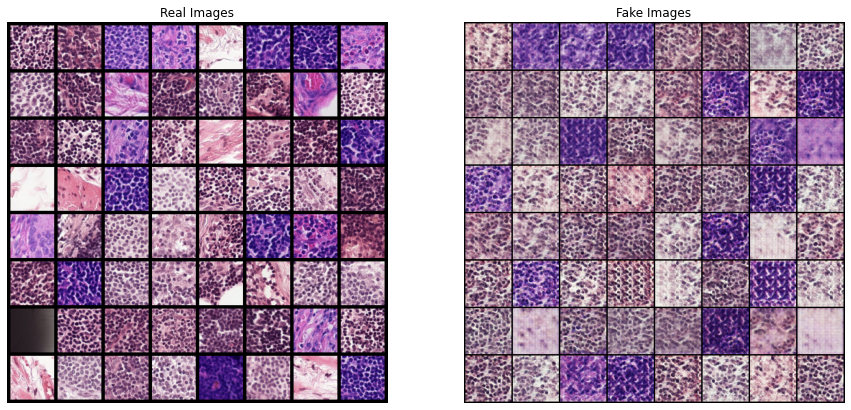

In [14]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

In [15]:
# we need 60,000 of these to do a fair test
30000 / 64

468.75

In [16]:
# so 938 batches and remove the last 32 (perhaps) - just get rid of it in sampling
from pathgen.utils.paths import project_root
from pathgen.utils.convert import np_to_pil

experiment_name = "one"
experiment_root = project_root() / "experiments" / experiment_name
output_dir = experiment_root / "fake_patches" / "normal"

def generate_fake_batch(generator):
    b_size = 64
    noise = torch.randn(b_size, nz, 1, 1, device=device)
    batch = generator(noise)
    images = []
    for sample in batch:
        MEAN = torch.tensor([0.5, 0.5, 0.5], device=device)
        STD = torch.tensor([0.5, 0.5, 0.5], device=device)
        x = sample * STD[:, None, None] + MEAN[:, None, None]
        image = x.detach().cpu().numpy().transpose(1,2,0)
        images.append(image)
    return images

for batch_idx in range(469):
    fake_batch = generate_fake_batch(netG)
    for img_idx, np_image in enumerate(fake_batch):
        img = np_to_pil(np_image)
        img.save(output_dir / f"{batch_idx}-{img_idx}.png")